# Demo for frequency dependent absorption in `pyroomacoustics`

## imports

In [1]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.io import wavfile
import IPython
import pyroomacoustics as pra
import warnings
warnings.filterwarnings("ignore",category=FutureWarning)

<a id='rir'></a>
## Room impulse response (RIR) generation and propagation simulation

Using the Image Source Model (ISM) we can compute the impulse response for each microphone. From the `Room` constructor it is possible to set the maximum ISM order and the absorption coefficient for 125,250,500,1000,2000,4000 Hz. This example creates a simple cubic room of side length 5 and height 2. All walls have similar absorption, that is maximally reflective up to 2000 Hz and maximally absorbant after 4000 Hz

In [2]:
corners = np.array([[0,0], [0,5], [5,5], [5,0]]).T  # [x,y]

In [3]:
abso = [0,0,0,0,0,0.99]
absorption = [[0,0,0,0,0,0.99],
               [0,0,0,0,0,0.99],
               [0,0,0,0,0,0.99],
               [0,0,0,0,0,0.99]]
abs_ceil_floor = [[0,0,0,0,0,0.99],
                  [0,0,0,0,0,0.99]]

In [4]:
abs_test = dict({'east': abso, 'west':abso, 'north':abso, 'south':abso, 'ceiling':abso, 'floor':abso,})

We can then create a room with the chosen corners and absorption. The test audio input is a frequency sweepfrom 1 to 44100 Hz to show how the sound behaves with frequency changes.

In [5]:
# specify signal source
fs, signal = wavfile.read("test.wav")
# set max_order to a low value for a quick (but less accurate) RIR
#room = pra.Room.from_corners(corners, fs=fs, max_order=3, absorption=absorption)
room = pra.ShoeBox([5,5,2], fs=fs, max_order=3, absorption = abs_test)
#room.extrude(2., absorption = abs_ceil_floor)

# add source and set the signal to WAV file content
room.add_source([4., 3., 1.], signal=signal)

# add two-microphone array
R = np.array([[1.], [3.], [1.]])  # [[x], [y], [z]]
room.add_microphone_array(pra.MicrophoneArray(R, room.fs))

In [6]:
# compute image sources
room.image_source_model(use_libroom=False)

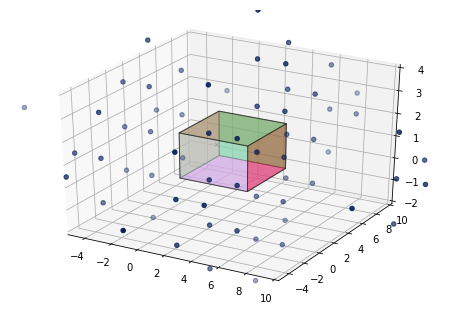

In [7]:
# visualize 3D polyhedron room and image sources
fig, ax = room.plot(img_order=3)
ax.set_xlim([-5, 10])
ax.set_ylim([-5, 10])
ax.set_zlim([-2, 4]);

Moreover, we can plot the RIR for each microphone once the image sources have been computed. Each plot corresponds to a center frequency. We can observe that the room is maximally absorbant (i.e. only direct sound remains) for 4000 HZ.

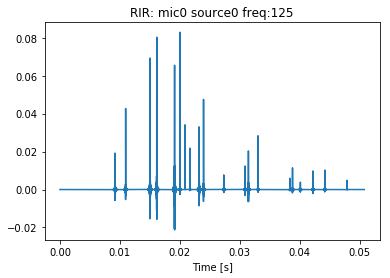

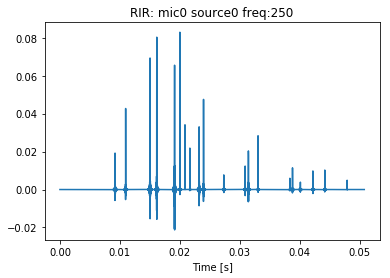

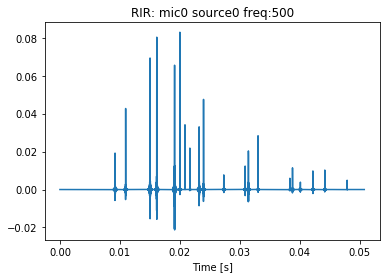

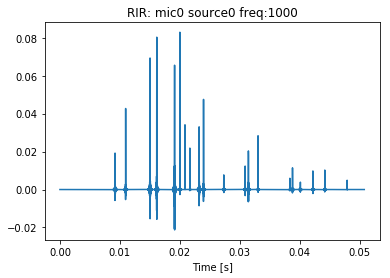

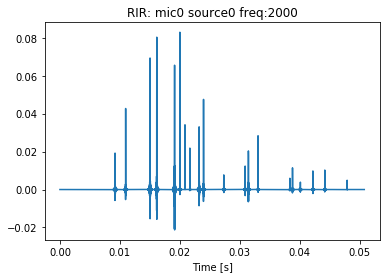

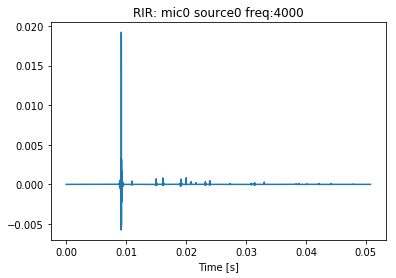

<Figure size 1440x720 with 0 Axes>

In [8]:
room.plot_rir()
fig = plt.gcf()
fig.set_size_inches(20, 10)

Moreover, we can simulate our signal convolved with these impulse responses as such: There are two filtering methods available. We can chose between a FIR window method or butterworth method for bandpass filtering.

In [9]:
room.simulate(filter_method='firwin')

Let's listen to the output!

In [10]:
# original signal
print("Original WAV:")
IPython.display.Audio(signal, rate=fs)

Original WAV:


In [11]:
print("Simulated propagation to first mic with firwin method:")
IPython.display.Audio(room.mic_array.signals[0], rate=fs)

Simulated propagation to first mic with firwin method:


In [12]:
room.simulate(filter_method='butter')

In [13]:
print("Simulated propagation to first mic with butterworth method:")
IPython.display.Audio(room.mic_array.signals[0], rate=fs)

Simulated propagation to first mic with butterworth method:


We can observe that the output signal has a lot of reverb for the low frequencies and becomes very dry afterwards